<a href="https://colab.research.google.com/github/Van314159/RL/blob/main/SAC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Soft Actor-Critic (SAC)

📅 *2025-06-30*  
📖 *Reference: Chapter 12,* **Grokking Deep Reinforcement Learning** *(2020)*

This notebook implements and trains a SAC agent to solve the HalfCheetah-v5 and Hopper-v5 environments from Gymnasium. SAC is an off-policy actor-critic algorithm that aims to maximize expected reward while also maximizing entropy.

Note to use the MuJoCo environments like HalfCheetah-v5 and Hopper-v5, we **must** work in the GPU.

In [1]:
import numpy as np
import gymnasium as gym
from gym import spaces
import random
import matplotlib.pyplot as plt
from statistics import mean # For mean reward logging
import pickle # For saving/loading the best episode trajectory
from collections import deque
import collections
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from tqdm import tqdm
from torch.distributions import Categorical
import os
from itertools import count

from google.colab import drive
drive.mount('/content/drive')
DIR = "/content/drive/My Drive/TensorBoard"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")
SEEDS = (12, 34, 56, 78, 90)

Using device: cuda


In [47]:
import imageio
from IPython.display import Video, display
def visualize_and_generate_video_SAC(trained_net, env, video_filename='agent_interaction.mp4'):

    device = next(trained_net.parameters()).device

    print("--- Starting visualization ---")
    trained_net.eval()

    frames = []
    obs, _ = env.reset()
    done = False
    episode_reward = 0
    with torch.no_grad():
        while not done:
            obs_tensor = torch.as_tensor(obs, dtype=torch.float32, device=device).unsqueeze(0)
            action_tensor = trained_net.deterministic(obs_tensor)
            action = action_tensor.detach().cpu().numpy().flatten()

            # Apply the action to the environment
            obs, reward, terminated, truncated, info = env.step(action)
            done = terminated or truncated

            episode_reward += reward

            # Render the environment to an RGB array and add it to our list of frames
            frame = env.render()
            frames.append(frame)

    trained_net.train()
    env.close()

    print(f"--- Visualization complete. Total reward: {episode_reward:.2f} ---")

    # Use imageio to save the collected frames as a video (MP4 format)
    print(f"--- Saving video to {video_filename} ---")
    with imageio.get_writer(video_filename, fps=30) as video:
        for frame in frames:
            video.append_data(frame)
    print("--- Video saved successfully ---")

    # Display the generated video directly in the Colab output
    display(Video(video_filename, embed=True, width=600))

## Twin Q-value network

In [4]:
# SAC's twin Q-function network.
class QTwinNetwork(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dim=(32,32),
                 activation=F.relu):
        super().__init__()
        self.activation = activation

        # Construct sequence deep network
        self.input_layer_a = nn.Linear(input_dim+output_dim, hidden_dim[0])
        self.input_layer_b = nn.Linear(input_dim+output_dim, hidden_dim[0])
        self.hidden_layers_a = nn.ModuleList()
        self.hidden_layers_b = nn.ModuleList()
        for i in range(len(hidden_dim)-1):
            hidden_layer_a = nn.Linear(hidden_dim[i], hidden_dim[i+1])
            hidden_layer_b = nn.Linear(hidden_dim[i], hidden_dim[i+1])
            self.hidden_layers_a.append(hidden_layer_a)
            self.hidden_layers_b.append(hidden_layer_b)

        self.output_layer_a = nn.Linear(hidden_dim[-1], 1)
        self.output_layer_b = nn.Linear(hidden_dim[-1], 1)

    def forward(self, state, action):
        x = torch.cat([state, action], dim=1)
        xa = self.activation(self.input_layer_a(x))
        xb = self.activation(self.input_layer_b(x))

        for hidden_layer_a, hidden_layer_b in zip(self.hidden_layers_a,self.hidden_layers_b):
            xa = self.activation(hidden_layer_a(xa))
            xb = self.activation(hidden_layer_b(xb))

        return self.output_layer_a(xa), self.output_layer_b(xb)

    def Qmin(self, state, action):
        xa, xb = self.forward(state, action)
        return torch.min(xa, xb)



In [5]:
# SAC Gaussian policy network
from torch.distributions import Normal

class PolicyNet(nn.Module):
    def __init__(self, input_dim, action_bounds,
                 hidden_dims=(32,32), activation=F.relu,
                 log_std_min=-20, log_std_max = 2):
        super().__init__()
        self.activation = activation
        self.log_std_min = log_std_min
        self.log_std_max = log_std_max

        env_min, env_max = action_bounds
        self.register_buffer("env_min", torch.tensor(env_min, dtype=torch.float32))
        self.register_buffer("env_max", torch.tensor(env_max, dtype=torch.float32))

        # Construct net
        self.input_layer = nn.Linear(input_dim, hidden_dims[0])
        self.hidden_layers = nn.ModuleList()
        for i in range(len(hidden_dims)-1):
            hidden_layer = nn.Linear(hidden_dims[i], hidden_dims[i+1])
            self.hidden_layers.append(hidden_layer)
        self.output_layer_mean = nn.Linear(hidden_dims[-1], len(env_max))
        self.output_layer_log_std = nn.Linear(hidden_dims[-1], len(env_max))

        #self.traget_entropy = -np.prod(self.env_max.shape).item()
        #self.log_alpha = torch.zeros(1, requires_grad=True, device=device)
        #self.alpha_optimizer = optim.Adam([self.log_alpha], lr=entropy_lr)

    def forward(self, state):
        x = self.activation(self.input_layer(state))
        for hidden_layer in self.hidden_layers:
            x = self.activation(hidden_layer(x))
        x_mean = self.output_layer_mean(x)
        x_log_std = self.output_layer_log_std(x)
        x_log_std = torch.clamp(x_log_std, self.log_std_min, self.log_std_max)
        return x_mean, x_log_std

    def full_pass(self, state, epsilon=1e-6):
        mean, log_std = self.forward(state)
        std = log_std.exp()
        normal = Normal(mean, std)
        z = normal.rsample()
        tanh_z = torch.tanh(z)
        action = self.rescale_fn(tanh_z)

        # log p(a) = log p(u) - log(da/du), where a = tanh(u)
        # The derivative of tanh(u) is 1 - tanh(u)^2.
        # Add a small epsilon for numerical stability.
        log_prob = normal.log_prob(z) - torch.log(1-tanh_z.pow(2) + epsilon)
        log_prob = log_prob.sum(dim=1, keepdim=True)

        return action, log_prob, self.rescale_fn(torch.tanh(mean))


    def rescale_fn(self, x):
        return self.env_min + 0.5 * (x + 1.0) * (self.env_max - self.env_min)

    def deterministic(self, state: torch.Tensor):
        mean, _ = self.forward(state)
        return self.rescale_fn(torch.tanh(mean))

In [6]:
class ReplayBuffer:
    def __init__(self, state_dim, action_dim, max_size=100_000, batch_size=64, device="cpu"):
        self.max_size = max_size
        self.batch_size = batch_size
        self.device = device

        # Preallocate fixed-size numpy arrays
        self.state_buf = np.zeros((self.max_size, state_dim), dtype=np.float32)
        self.action_buf = np.zeros((self.max_size, action_dim), dtype=np.float32)
        self.reward_buf = np.zeros((self.max_size, 1), dtype=np.float32)
        self.next_state_buf = np.zeros((self.max_size, state_dim), dtype=np.float32)
        self.done_buf = np.zeros((self.max_size, 1), dtype=np.float32)

        # Pointers.
        self._ptr = 0
        self.size = 0

    def store(self, state, action, reward, next_state, done):
        # Add a new step (s,a,r,s',d).
        self.state_buf[self._ptr] = state
        self.action_buf[self._ptr] = action
        self.reward_buf[self._ptr] = reward
        self.next_state_buf[self._ptr] = next_state
        self.done_buf[self._ptr] = done

        self._ptr = (self._ptr + 1) % self.max_size
        self.size = min(self.size + 1, self.max_size)

    def sample(self, batch_size=None):
        if batch_size is None:
            batch_size = self.batch_size
        idxs = np.random.choice(self.size, batch_size, replace=False)

        # Return as PyTorch tensors on correct device
        return (
            torch.tensor(self.state_buf[idxs], dtype=torch.float32, device=self.device),
            torch.tensor(self.action_buf[idxs], dtype=torch.float32, device=self.device),
            torch.tensor(self.reward_buf[idxs], dtype=torch.float32, device=self.device),
            torch.tensor(self.next_state_buf[idxs], dtype=torch.float32, device=self.device),
            torch.tensor(self.done_buf[idxs], dtype=torch.float32, device=self.device),
        )

    def __len__(self):
        return self.size

In [27]:
# SAC agent
import time
from datetime import datetime
import pytz
import copy

class SACAgent():
    def __init__(self, env, policy_net, policy_max_grad_norm, policy_lr,
                 twin_value_net, value_max_grad_norm, value_lr, tau, gamma,
                 policy_update_freq, alpha=None,
                 device="cpu", save_every_episodes=100):

        self.policy_update_freq = policy_update_freq


        self.tau = tau
        self.gamma = gamma
        self.device = device
        self.train_step = 0
        self.total_env_step = 0
        self.save_every_episodes = save_every_episodes

        self.env = env
        self.env_name = getattr(env, "spec", None).id if getattr(env, "spec", None) else "UnknownEnv"
        self.action_low = torch.tensor(env.action_space.low, dtype=torch.float32, device=device)
        self.action_high = torch.tensor(env.action_space.high, dtype=torch.float32, device=device)

        # Set Online net
        self.online_policy_net = policy_net.to(device)
        self.online_value_net = twin_value_net.to(device)

        # Set Target network.
        self.target_value_net = copy.deepcopy(self.online_value_net)
        self.target_value_net.load_state_dict(self.online_value_net.state_dict())
        self.target_value_net.eval()

        # Optimizers
        self.policy_optimizer = torch.optim.Adam(self.online_policy_net.parameters(), lr=policy_lr)
        self.value_optimizer = torch.optim.Adam(self.online_value_net.parameters(), lr=value_lr)
        self.policy_max_grad_norm = policy_max_grad_norm
        self.value_max_grad_norm = value_max_grad_norm

        # Alpha setup: Automatic tuning ---
        if isinstance(alpha, float):
            self.alpha = alpha
            self.tune_alpha = False
            print(f"Using fixed alpha: {self.alpha}")
        else:
            self.tune_alpha = True
            self.target_entropy = -torch.prod(torch.Tensor(self.env.action_space.shape).to(self.device)).item()
            # We optimize log_alpha instead of alpha for stability
            self.log_alpha = torch.zeros(1, requires_grad=True, device=device)
            self.alpha_optimizer = optim.Adam([self.log_alpha], lr=policy_lr) # Can use policy_lr
            self.alpha = self.log_alpha.exp().item()
            print(f"Using automatic alpha tuning. Target Entropy: {self.target_entropy:.2f}")

        # TensorBoard Setup
        tokyo = pytz.timezone('Asia/Tokyo')
        timestamp = datetime.now(tokyo).strftime('%Y%m%d-%H%M')
        log_dir = os.path.join(DIR, f"{timestamp}_{self.env_name}_SAC")
        os.makedirs(log_dir, exist_ok=True)
        self.writer = SummaryWriter(log_dir)
        print(f"TensorBoard logs being written to: {log_dir}")

    def train(self, replay_buffer, batch_size,
              max_minutes, max_episodes, goal_mean_100_reward):

        self.replay_buffer = replay_buffer

        self.total_env_step = 0
        scores = []

        start_time = time.time()

        # Collect experiences
        for episode in range(1, max_episodes + 1):
            episode_step = 0
            obs, _ = self.env.reset()
            done = False
            total_reward = 0
            while not done:
                episode_step += 1
                obs_tensor = torch.as_tensor(obs, dtype=torch.float32, device=self.device).unsqueeze(0)
                action_tensor, _, _ = self.online_policy_net.full_pass(obs_tensor)
                action = action_tensor.detach().cpu().numpy().flatten()
                next_obs, reward, terminated, truncated, _ = self.env.step(action)
                done = terminated or truncated

                replay_buffer.store(obs, action, reward, next_obs, float(done))
                obs = next_obs
                total_reward += reward
                self.total_env_step += 1

                if len(self.replay_buffer) >= batch_size:
                    self.update_online_model(self.replay_buffer.sample(batch_size))


            scores.append(total_reward)
            mean_100 = np.mean(scores[-100:])

            if episode % 10 == 0:
                print(f"Episode {episode} | Reward: {total_reward:.1f} | Mean(100): {mean_100:.1f}")

            if mean_100 >= goal_mean_100_reward:
                print("🎯 Goal achieved!")
                break

            elapsed = time.time() - start_time
            if elapsed > max_minutes * 60:
                print("⏰ Time budget exceeded.")
                break

            self.writer.add_scalar("Reward/Episode", total_reward, episode)
            self.writer.add_scalar("Reward/Mean100", mean_100, episode)

            if episode % self.save_every_episodes == 0:
                save_dir = self.writer.log_dir
                save_path = os.path.join(save_dir, f"Policy_episode_{episode}_step_{self.total_env_step}.pth")
                print(f"\n--- Saving model checkpoint to {save_path} ---")
                torch.save(self.online_policy_net.state_dict(), save_path)
        final_score, std = self.evaluate(n_episode=10)
        # --- Also save the final model at the very end of training ---
        final_save_path = os.path.join(self.writer.log_dir, "actor_final.pth")
        print(f"\n--- Saving final model to {final_save_path} ---")
        torch.save(self.online_policy_net.state_dict(), final_save_path)

        self.env.close()
        self.writer.close()
        print(f"\n✅ Training complete. Final eval: {final_score:.2f} ± {std:.2f}")
        return final_score

    def evaluate(self, n_episode=1):
        rs = []
        self.online_policy_net.eval()
        with torch.no_grad():
            for _ in range(n_episode):
                obs, _ = self.env.reset()
                is_done = False
                episode_rs = 0
                while not is_done:
                    obs_tensor = torch.tensor(obs, dtype=torch.float32, device=self.device).unsqueeze(0)
                    action_tensor = self.online_policy_net.deterministic(obs_tensor)
                    action = action_tensor.detach().cpu().numpy().flatten()
                    next_obs, reward, termin, trunc, _ = self.env.step(action)
                    is_done = termin or trunc
                    episode_rs += reward
                    obs = next_obs

                rs.append(episode_rs)

        self.online_policy_net.train()
        return np.mean(rs), np.std(rs)


    def update_online_model(self, batch):
        self.train_step += 1
        # Compare to a public target network which is updated regularly.
        states, actions, rewards, next_states, dones = batch
        states = states.to(self.device)
        actions = actions.to(self.device)
        rewards = rewards.to(self.device)
        next_states = next_states.to(self.device)
        dones = dones.to(self.device)


        # Add noise to the action.
        with torch.no_grad():
            action_preds, log_prob_preds, _ = self.online_policy_net.full_pass(next_states)
            next_values_a, next_values_b = self.target_value_net(next_states, action_preds)
            next_values = torch.min(next_values_a, next_values_b)
            target_values = rewards + (1 - dones) * self.gamma * (next_values - self.alpha * log_prob_preds)



        # calculate the joint value loss and update private network.
        value_a, value_b = self.online_value_net(states, actions)
        value_loss = F.mse_loss(target_values, value_a) + F.mse_loss(target_values, value_b)

        self.value_optimizer.zero_grad()
        value_loss.backward()
        nn.utils.clip_grad_norm_(self.online_value_net.parameters(), self.value_max_grad_norm)
        self.value_optimizer.step()

        self.writer.add_scalar("Loss/Value", value_loss.item(), self.total_env_step)
        self.writer.add_scalar("Q_value/Target", target_values.mean().item(), self.total_env_step)
        self.writer.add_scalar("Q_value/OnlineA", value_a.mean().item(), self.total_env_step)
        self.writer.add_scalar("Q_value/OnlineB", value_b.mean().item(), self.total_env_step)

        # calculate policy loss
        if self.train_step % self.policy_update_freq == 0:
            for p in self.online_value_net.parameters():
                p.requires_grad = False

            action, log_prob, _ = self.online_policy_net.full_pass(states)
            value_a, value_b = self.online_value_net(states, action)
            value = torch.min(value_a, value_b)
            policy_loss = (self.alpha * log_prob - value).mean()

            self.policy_optimizer.zero_grad()
            policy_loss.backward()
            nn.utils.clip_grad_norm_(self.online_policy_net.parameters(), self.policy_max_grad_norm)
            self.policy_optimizer.step()
            self.writer.add_scalar("Loss/Policy", policy_loss.item(), self.train_step)

            for p in self.online_value_net.parameters():
                p.requires_grad = True

            if self.tune_alpha:
                alpha_loss = -(self.log_alpha * (log_prob + self.target_entropy).detach()).mean()
                self.alpha_optimizer.zero_grad()
                alpha_loss.backward()
                self.alpha_optimizer.step()
                self.alpha = self.log_alpha.exp().item()
                self.writer.add_scalar("Loss/Alpha", alpha_loss.item(), self.train_step)
                self.writer.add_scalar("Alpha", self.alpha, self.train_step)

            self.update_target_model()



    def update_target_model(self):
        with torch.no_grad():
            for target_param, param in zip(self.target_value_net.parameters(), self.online_value_net.parameters()):
                target_param.data.copy_(self.tau * param.data + (1 - self.tau) * target_param.data)



# Test

In [8]:
!pip install mujoco

# Set up GPU rendering.
from google.colab import files
import distutils.util
import os
import subprocess
if subprocess.run('nvidia-smi').returncode:
  raise RuntimeError(
      'Cannot communicate with GPU. '
      'Make sure you are using a GPU Colab runtime. '
      'Go to the Runtime menu and select Choose runtime type.')

# Add an ICD config so that glvnd can pick up the Nvidia EGL driver.
# This is usually installed as part of an Nvidia driver package, but the Colab
# kernel doesn't install its driver via APT, and as a result the ICD is missing.
# (https://github.com/NVIDIA/libglvnd/blob/master/src/EGL/icd_enumeration.md)
NVIDIA_ICD_CONFIG_PATH = '/usr/share/glvnd/egl_vendor.d/10_nvidia.json'
if not os.path.exists(NVIDIA_ICD_CONFIG_PATH):
  with open(NVIDIA_ICD_CONFIG_PATH, 'w') as f:
    f.write("""{
    "file_format_version" : "1.0.0",
    "ICD" : {
        "library_path" : "libEGL_nvidia.so.0"
    }
}
""")

# Configure MuJoCo to use the EGL rendering backend (requires GPU)
print('Setting environment variable to use GPU rendering:')
%env MUJOCO_GL=egl

# Check if installation was successful.
try:
  print('Checking that the installation succeeded:')
  import mujoco as mj
  mj.MjModel.from_xml_string('<mujoco/>')
except Exception as e:
  raise e from RuntimeError(
      'Something went wrong during installation. Check the shell output above '
      'for more information.\n'
      'If using a hosted Colab runtime, make sure you enable GPU acceleration '
      'by going to the Runtime menu and selecting "Choose runtime type".')

print('Installation successful.')

# Other imports and helper functions
import numpy as np
import random
from scipy.signal import convolve2d

# Graphics and plotting.
print('Installing mediapy:')
!command -v ffmpeg >/dev/null || (apt update && apt install -y ffmpeg)
!pip install -q mediapy
import mediapy as media
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Printing.
np.set_printoptions(precision=3, suppress=True, linewidth=100)
import pygments
from google.colab import output

from IPython.display import clear_output, HTML, display
clear_output()


is_dark = output.eval_js('document.documentElement.matches("[theme=dark]")')
print_style = 'monokai' if is_dark else 'lovelace'

def print_xml(xml_string):
  formatter = pygments.formatters.HtmlFormatter(style=print_style)
  lexer = pygments.lexers.XmlLexer()
  highlighted = pygments.highlight(xml_string, lexer, formatter)
  display(HTML(f"<style>{formatter.get_style_defs()}</style>{highlighted}"))

def render(model, data=None, height=300, camera=-1):
  if data is None:
    data = mj.MjData(model)
  with mj.Renderer(model, 480, 640) as renderer:
    mj.mj_forward(model, data)
    renderer.update_scene(data, camera)
    media.show_image(renderer.render(), height=height)

In [9]:
import gymnasium as gym
env = gym.make('HalfCheetah-v5', render_mode="rgb_array")

array([[[168, 168, 168],
        [168, 168, 168],
        [168, 168, 168],
        ...,
        [168, 168, 168],
        [168, 168, 168],
        [168, 168, 168]],

       [[168, 168, 168],
        [168, 168, 168],
        [168, 168, 168],
        ...,
        [168, 168, 168],
        [168, 168, 168],
        [168, 168, 168]],

       [[168, 168, 168],
        [168, 168, 168],
        [168, 168, 168],
        ...,
        [168, 168, 168],
        [168, 168, 168],
        [168, 168, 168]],

       ...,

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [180, 203, 180],
        [180, 203, 180],
        [180, 203, 180]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [180, 203, 180],
        [180, 203, 180],
        [180, 203, 180]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [180, 203, 180],
        [180, 203, 180],
        [180, 203, 180]]], dtype=uint8)
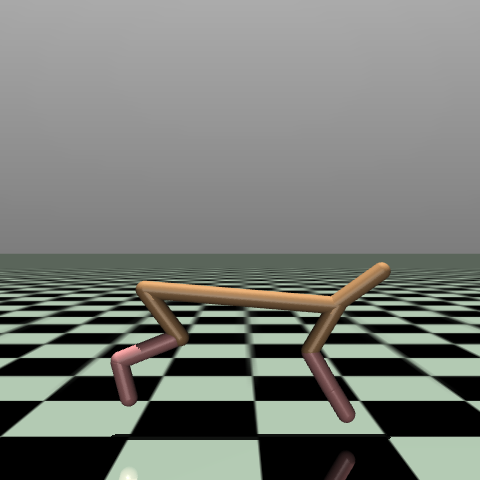

In [10]:
env.reset()
env.render()

In [11]:
GAMMA = 0.99
MAX_MINUTES = 300
MAX_EPISODES = 10000
GOAL_MEAN_100_REWARD = 2000
POLICY_LR = 0.0003
VALUE_LR = 0.0005
TAU = 0.001
POLICY_UPDATE_FREQ = 1
HIDDEN_DIM = (256, 256)
LR = 3e-4

In [12]:
state_dim = env.observation_space.shape[0]        # (3,)
action_dim = env.action_space.shape[0]         # 1
action_low = env.action_space.low              # array([-2.])
action_high = env.action_space.high            # array([2.])
action_bounds = (action_low, action_high)

In [13]:
policynet = PolicyNet(input_dim=state_dim, action_bounds=action_bounds, hidden_dims=HIDDEN_DIM)
value_net = QTwinNetwork(input_dim=state_dim, output_dim=action_dim, hidden_dim=HIDDEN_DIM)

In [14]:
# Test if the policy net and value net work.
obs, _ = env.reset()
obs_tensor = torch.tensor(obs, dtype=torch.float32,device=device).unsqueeze(0)
policynet.to(device)
value_net.to(device)
action = policynet.deterministic(obs_tensor)
value_net(obs_tensor, action)

(tensor([[-0.0224]], device='cuda:0', grad_fn=<AddmmBackward0>),
 tensor([[-0.0471]], device='cuda:0', grad_fn=<AddmmBackward0>))

In [44]:
sac_agent = SACAgent(env,policy_net=policynet, policy_max_grad_norm=2.0,policy_lr=LR,
                        twin_value_net=value_net, value_max_grad_norm=2.0, value_lr=LR,
                        policy_update_freq=POLICY_UPDATE_FREQ,
                        gamma=GAMMA,
                       tau=TAU, device=device)

Using automatic alpha tuning. Target Entropy: -6.00
TensorBoard logs being written to: /content/drive/My Drive/TensorBoard/20250630-1224_HalfCheetah-v5_SAC


In [45]:
replay_buffer = ReplayBuffer(max_size=1000000, batch_size=256,
                             state_dim=state_dim, action_dim=action_dim, device=device)

In [46]:
sac_agent.train(replay_buffer=replay_buffer, batch_size=256,
                 max_minutes=300, max_episodes=MAX_EPISODES,
                 goal_mean_100_reward=GOAL_MEAN_100_REWARD)

Episode 10 | Reward: -127.7 | Mean(100): -199.0
Episode 20 | Reward: -66.5 | Mean(100): -150.3
Episode 30 | Reward: 107.9 | Mean(100): -102.7
Episode 40 | Reward: 333.1 | Mean(100): -21.5
Episode 50 | Reward: 1394.3 | Mean(100): 146.6
Episode 60 | Reward: 1918.1 | Mean(100): 324.6
Episode 70 | Reward: 3043.8 | Mean(100): 634.5
Episode 80 | Reward: 3539.9 | Mean(100): 955.7
Episode 90 | Reward: 4053.1 | Mean(100): 1263.8
Episode 100 | Reward: 4141.5 | Mean(100): 1536.9

--- Saving model checkpoint to /content/drive/My Drive/TensorBoard/20250630-1224_HalfCheetah-v5_SAC/Policy_episode_100_step_100000.pth ---
Episode 110 | Reward: 4218.4 | Mean(100): 1969.0
🎯 Goal achieved!


RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu! (when checking argument for argument mat1 in method wrapper_CUDA_addmm)

In [58]:
test_env = gym.make('HalfCheetah-v5', render_mode="rgb_array")
test_env.reset()
visualize_and_generate_video_SAC(sac_agent.online_policy_net, test_env, video_filename='agent_interaction.mp4')


--- Starting visualization ---
--- Visualization complete. Total reward: 4210.07 ---
--- Saving video to agent_interaction.mp4 ---
--- Video saved successfully ---


### Compare with a non-trained model with saved model

In [15]:
trained_policy_net = PolicyNet(input_dim=state_dim, action_bounds=action_bounds, hidden_dims=HIDDEN_DIM)
model_path = os.path.join(DIR, "20250630-1224_HalfCheetah-v5_SAC/Policy_episode_100_step_100000.pth")
trained_policy_net.load_state_dict(torch.load(model_path))
trained_policy_net.to(device)
trained_policy_net.eval()

policynet_test = PolicyNet(input_dim=state_dim, action_bounds=action_bounds, hidden_dims=HIDDEN_DIM)
policynet_test.to(device)

PolicyNet(
  (input_layer): Linear(in_features=17, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=256, bias=True)
  )
  (output_layer_mean): Linear(in_features=256, out_features=6, bias=True)
  (output_layer_log_std): Linear(in_features=256, out_features=6, bias=True)
)

In [16]:
test_env = gym.make('HalfCheetah-v5', render_mode="rgb_array")
test_env.reset()

(array([-0.061,  0.08 ,  0.001, -0.038, -0.088,  0.022, -0.082,  0.023, -0.156, -0.141, -0.041,
         0.009, -0.077, -0.093, -0.107,  0.062,  0.049]),
 {'x_position': np.float64(0.09828215227893852)})

In [ ]:
visualize_and_generate_video_SAC(trained_policy_net, test_env, video_filename='agent_interaction_trained.mp4')
test_env.close()

In [29]:
test_env.close()

array([[[168, 168, 168],
        [168, 168, 168],
        [168, 168, 168],
        ...,
        [168, 168, 168],
        [168, 168, 168],
        [168, 168, 168]],

       [[168, 168, 168],
        [168, 168, 168],
        [168, 168, 168],
        ...,
        [168, 168, 168],
        [168, 168, 168],
        [168, 168, 168]],

       [[168, 168, 168],
        [168, 168, 168],
        [168, 168, 168],
        ...,
        [168, 168, 168],
        [168, 168, 168],
        [168, 168, 168]],

       ...,

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [180, 203, 180],
        [180, 203, 180],
        [180, 203, 180]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [180, 203, 180],
        [180, 203, 180],
        [180, 203, 180]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [180, 203, 180],
        [180, 203, 180],
        [180, 203, 180]]], dtype=uint8)
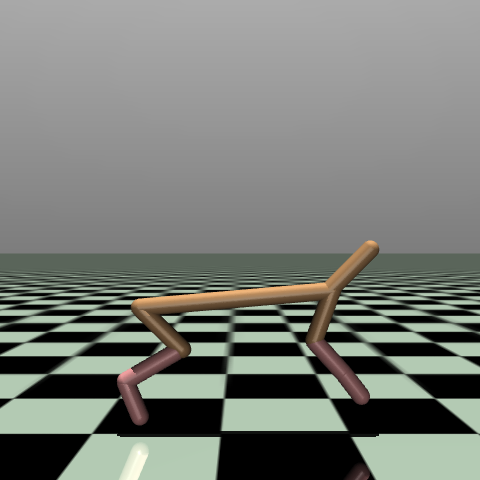

In [31]:
test_env = gym.make('HalfCheetah-v5', render_mode="rgb_array")
test_env.reset()
test_env.render()

In [59]:
%load_ext tensorboard
%tensorboard --logdir "/content/drive/My Drive/TensorBoard/"

<IPython.core.display.Javascript object>

## Train the Hopper-v5 Env. Compare with TD3 method.

array([[[ 67,  84, 101],
        [ 67,  84, 101],
        [ 67,  84, 101],
        ...,
        [ 67,  84, 101],
        [ 67,  84, 101],
        [ 67,  84, 101]],

       [[ 67,  84, 101],
        [ 67,  84, 101],
        [ 67,  84, 101],
        ...,
        [ 67,  84, 101],
        [ 67,  84, 101],
        [ 67,  84, 101]],

       [[ 67,  84, 101],
        [ 67,  84, 101],
        [ 67,  84, 101],
        ...,
        [ 67,  84, 101],
        [ 67,  84, 101],
        [ 67,  84, 101]],

       ...,

       [[179, 202, 179],
        [179, 202, 179],
        [129, 145, 129],
        ...,
        [106, 119, 106],
        [ 40,  44,  40],
        [  0,   0,   0]],

       [[179, 202, 179],
        [131, 146, 131],
        [ 63,  70,  63],
        ...,
        [164, 185, 164],
        [107, 120, 107],
        [ 37,  43,  37]],

       [[131, 146, 131],
        [ 63,  70,  63],
        [  9,  10,   9],
        ...,
        [179, 202, 179],
        [164, 185, 164],
        [107, 120, 107]]], dtype=uint8)
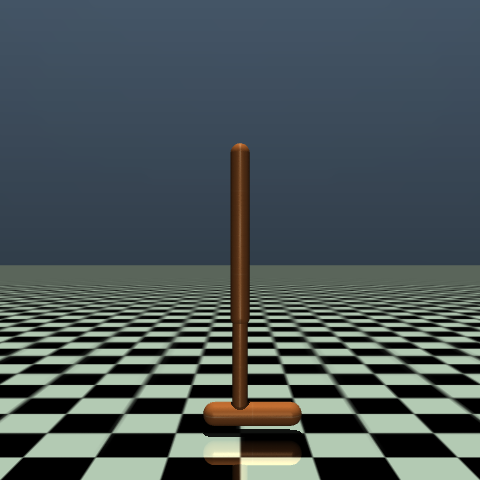

In [19]:
env = gym.make("Hopper-v5", render_mode="rgb_array")
env.reset()
env.render()

In [20]:
state_dim = env.observation_space.shape[0]        # (3,)
action_dim = env.action_space.shape[0]         # 1
action_low = env.action_space.low              # array([-2.])
action_high = env.action_space.high            # array([2.])
action_bounds = (action_low, action_high)

In [29]:
policynet = PolicyNet(input_dim=state_dim, action_bounds=action_bounds, hidden_dims=HIDDEN_DIM)
value_net = QTwinNetwork(input_dim=state_dim, output_dim=action_dim, hidden_dim=HIDDEN_DIM)
sac_agent = SACAgent(env,policy_net=policynet, policy_max_grad_norm=2.0,policy_lr=LR,
                        twin_value_net=value_net, value_max_grad_norm=2.0, value_lr=LR,
                        policy_update_freq=POLICY_UPDATE_FREQ,
                        gamma=GAMMA,
                       tau=TAU, device=device)

Using automatic alpha tuning. Target Entropy: -3.00
TensorBoard logs being written to: /content/drive/My Drive/TensorBoard/20250630-1355_Hopper-v5_SAC


In [30]:
sac_agent.evaluate()

(np.float64(40.68524192682963), np.float64(0.0))

In [31]:
replay_buffer = ReplayBuffer(max_size=1000000, batch_size=256,
                             state_dim=state_dim, action_dim=action_dim, device=device)

In [32]:
sac_agent.train(replay_buffer=replay_buffer, batch_size=256,
                 max_minutes=300, max_episodes=MAX_EPISODES,
                 goal_mean_100_reward=1500)

Episode 10 | Reward: 9.9 | Mean(100): 22.0
Episode 20 | Reward: 34.0 | Mean(100): 22.7
Episode 30 | Reward: 7.5 | Mean(100): 23.3
Episode 40 | Reward: 11.9 | Mean(100): 22.5
Episode 50 | Reward: 13.2 | Mean(100): 24.4
Episode 60 | Reward: 9.6 | Mean(100): 28.0
Episode 70 | Reward: 86.2 | Mean(100): 38.8
Episode 80 | Reward: 103.1 | Mean(100): 47.6
Episode 90 | Reward: 218.2 | Mean(100): 55.6
Episode 100 | Reward: 192.2 | Mean(100): 64.3

--- Saving model checkpoint to /content/drive/My Drive/TensorBoard/20250630-1355_Hopper-v5_SAC/Policy_episode_100_step_4736.pth ---
Episode 110 | Reward: 183.4 | Mean(100): 81.4
Episode 120 | Reward: 186.9 | Mean(100): 97.8
Episode 130 | Reward: 189.6 | Mean(100): 113.7
Episode 140 | Reward: 197.2 | Mean(100): 130.6
Episode 150 | Reward: 190.4 | Mean(100): 146.1
Episode 160 | Reward: 189.2 | Mean(100): 160.3
Episode 170 | Reward: 184.2 | Mean(100): 168.5
Episode 180 | Reward: 183.3 | Mean(100): 176.7
Episode 190 | Reward: 197.0 | Mean(100): 184.1
Episo

np.float64(2595.429407438766)

In [33]:
test_env = gym.make("Hopper-v5", render_mode="rgb_array")
test_env.reset()
visualize_and_generate_video_SAC(sac_agent.online_policy_net, test_env, video_filename='agent_interaction_trained.mp4')
test_env.close()

--- Starting visualization ---
--- Visualization complete. Total reward: 3012.91 ---
--- Saving video to agent_interaction_trained.mp4 ---
--- Video saved successfully ---


In [50]:
trained_policy_net_middle = PolicyNet(input_dim=state_dim, action_bounds=action_bounds, hidden_dims=HIDDEN_DIM)
model_path = os.path.join(DIR, "20250630-1355_Hopper-v5_SAC/Policy_episode_1300_step_186477.pth")
trained_policy_net_middle.load_state_dict(torch.load(model_path))
trained_policy_net_middle.to(device)
trained_policy_net.eval()

policynet_test = PolicyNet(input_dim=state_dim, action_bounds=action_bounds, hidden_dims=HIDDEN_DIM)
policynet_test.to(device)

PolicyNet(
  (input_layer): Linear(in_features=11, out_features=256, bias=True)
  (hidden_layers): ModuleList(
    (0): Linear(in_features=256, out_features=256, bias=True)
  )
  (output_layer_mean): Linear(in_features=256, out_features=3, bias=True)
  (output_layer_log_std): Linear(in_features=256, out_features=3, bias=True)
)

In [51]:
test_env = gym.make("Hopper-v5", render_mode="rgb_array")
test_env.reset()
visualize_and_generate_video_SAC(trained_policy_net_middle, test_env, video_filename='agent_interaction_trained_SAC.mp4')
test_env.close()

--- Starting visualization ---
--- Visualization complete. Total reward: 2915.09 ---
--- Saving video to agent_interaction_trained_SAC.mp4 ---
--- Video saved successfully ---


In [ ]:
%load_ext tensorboard
#%reload_ext tensorboard
%tensorboard --logdir "/content/drive/My Drive/TensorBoard/"